In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random
from tqdm.notebook import tqdm
plt.rcParams['figure.figsize'] = [15, 15]

In [ ]:
def adjust_brightness_contrast(image, brightness=0, contrast=0):
    # Brightness adjustment
    if brightness != 0:
        if brightness > 0:
            shadow = brightness
            highlight = 255
        else:
            shadow = 0
            highlight = 255 + brightness
        alpha_b = (highlight - shadow)/255
        gamma_b = shadow

        # Apply brightness adjustment
        image = cv2.addWeighted(image, alpha_b, image, 0, gamma_b)

    # Contrast adjustment
    if contrast != 0:
        f = 131*(contrast + 127)/(127*(131-contrast))
        alpha_c = f
        gamma_c = 127*(1-f)

        # Apply contrast adjustment
        image = cv2.addWeighted(image, alpha_c, image, 0, gamma_c)

    return image


In [ ]:
def resize(image, image_h=500, ratio=3):
    """
    :param image:
    :param image_h: Zoom the picture to the same height, image_h cannot be too large, otherwise the calculation time will be too long
    :param ratio: ratio>1 Expand the edge of the picture to prevent the picture from being missed during spatial mapping. The larger the ratio, the less likely being missed
    :return:
    """
    # get height/width/chanel info of image
    height, width, chanel = image.shape
    # resized_height = image_h
    resize_h = image_h
    # resized_width = image width * image_h/image height
    resize_w = int(width * resize_h/height)
    # resize images: interpolation algorithm using bicubic interpolation
    image_resize = cv2.resize(image, (resize_w, resize_h), interpolation=cv2.INTER_CUBIC)
    image_expand = np.zeros((int(ratio*resize_h), int(ratio*resize_w), chanel), dtype=np.uint8)
    image_expand[resize_h//2:resize_h//2+resize_h, resize_w//2:resize_w//2+resize_w] = image_resize
    return image_resize 

# Read image and convert them to gray!!
def read_image(path):
    img = cv2.imread(path)
    img = resize(img)

    # Adjust brightness and contrast of image2 to match image1
    img = adjust_brightness_contrast(img, brightness=50, contrast=10)
    img_gray= cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img_gray, img, img_rgb

In [ ]:
left_gray, left_origin, left_rgb = read_image("CV-image/test/1/4.jpg")
right_gray, right_origin, right_rgb = read_image("CV-image/test/1/5.jpg")

In [ ]:
def SIFT(img):
    #siftDetector= cv2.xfeatures2d.SIFT_create() # limit 1000 points
    siftDetector= cv2.SIFT_create()  # depends on OpenCV version

    kp, des = siftDetector.detectAndCompute(img, None)
    return kp, des

def plot_sift(gray, rgb, kp):
    tmp = rgb.copy()
    img = cv2.drawKeypoints(gray, kp, tmp, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    return img

In [ ]:
# Better result when using gray
kp_left, des_left = SIFT(left_gray)
kp_right, des_right = SIFT(right_gray)

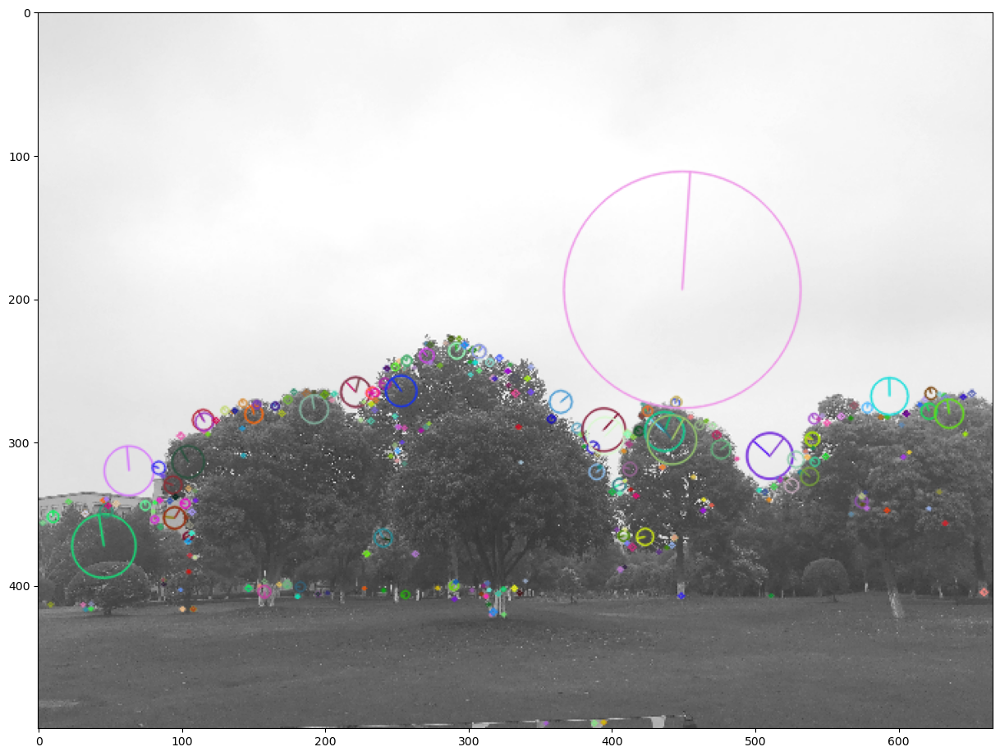

In [ ]:
kp_left_img = plot_sift(left_gray, left_rgb, kp_left)
kp_right_img = plot_sift(right_gray, right_rgb, kp_right)
# total_kp = np.concatenate((kp_left_img, kp_right_img), axis=1)
plt.imshow(kp_left_img)

In [ ]:
def matcher(kp1, des1, img1, kp2, des2, img2, threshold):
    # BFMatcher with default params
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1,des2, k=2)

    # Apply ratio test
    good = []
    for m,n in matches:
        if m.distance < threshold*n.distance:
            good.append([m])

    matches = []
    for pair in good:
        matches.append(list(kp1[pair[0].queryIdx].pt + kp2[pair[0].trainIdx].pt))

    matches = np.array(matches)
    return matches

In [ ]:
matches = matcher(kp_left, des_left, left_rgb, kp_right, des_right, right_rgb, 0.5)

In [ ]:
def plot_matches(matches, total_img):
    match_img = total_img.copy()
    offset = total_img.shape[1]/2
    fig, ax = plt.subplots()
    ax.set_aspect('equal')
    ax.imshow(np.array(match_img).astype('uint8')) #　RGB is integer type
    
    ax.plot(matches[:, 0], matches[:, 1], 'xr')
    ax.plot(matches[:, 2] + offset, matches[:, 3], 'xr')
     
    ax.plot([matches[:, 0], matches[:, 2] + offset], [matches[:, 1], matches[:, 3]],
            'r', linewidth=0.5)

    plt.show()

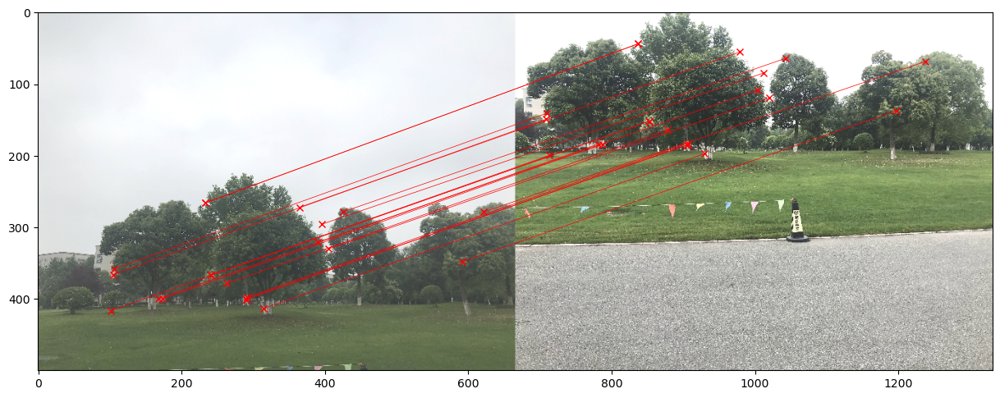

In [ ]:
total_img = np.concatenate((left_rgb, right_rgb), axis=1)
plot_matches(matches, total_img) # Good mathces

In [ ]:
def homography(pairs):
    rows = []
    for i in range(pairs.shape[0]):
        p1 = np.append(pairs[i][0:2], 1)
        p2 = np.append(pairs[i][2:4], 1)
        row1 = [0, 0, 0, p1[0], p1[1], p1[2], -p2[1]*p1[0], -p2[1]*p1[1], -p2[1]*p1[2]]
        row2 = [p1[0], p1[1], p1[2], 0, 0, 0, -p2[0]*p1[0], -p2[0]*p1[1], -p2[0]*p1[2]]
        rows.append(row1)
        rows.append(row2)
    rows = np.array(rows)
    U, s, V = np.linalg.svd(rows)
    H = V[-1].reshape(3, 3)
    H = H/H[2, 2] # standardize to let w*H[2,2] = 1
    return H

In [ ]:
def random_point(matches, k=4):
    idx = random.sample(range(len(matches)), k)
    point = [matches[i] for i in idx ]
    return np.array(point)

In [ ]:
def get_error(points, H):
    num_points = len(points)
    all_p1 = np.concatenate((points[:, 0:2], np.ones((num_points, 1))), axis=1)
    all_p2 = points[:, 2:4]
    estimate_p2 = np.zeros((num_points, 2))
    for i in range(num_points):
        temp = np.dot(H, all_p1[i])
        estimate_p2[i] = (temp/temp[2])[0:2] # set index 2 to 1 and slice the index 0, 1
    # Compute error
    errors = np.linalg.norm(all_p2 - estimate_p2 , axis=1) ** 2

    return errors

In [ ]:
def ransac(matches, threshold, iters):
    num_best_inliers = 0
    
    for i in range(iters):
        points = random_point(matches)
        H = homography(points)
        
        #  avoid dividing by zero 
        if np.linalg.matrix_rank(H) < 3:
            continue
            
        errors = get_error(matches, H)
        idx = np.where(errors < threshold)[0]
        inliers = matches[idx]

        num_inliers = len(inliers)
        if num_inliers > num_best_inliers:
            best_inliers = inliers.copy()
            num_best_inliers = num_inliers
            best_H = H.copy()
            
    print("inliers/matches: {}/{}".format(num_best_inliers, len(matches)))
    return best_inliers, best_H

In [ ]:
inliers, H = ransac(matches, 0.5, 2000)

inliers/matches: 14/21


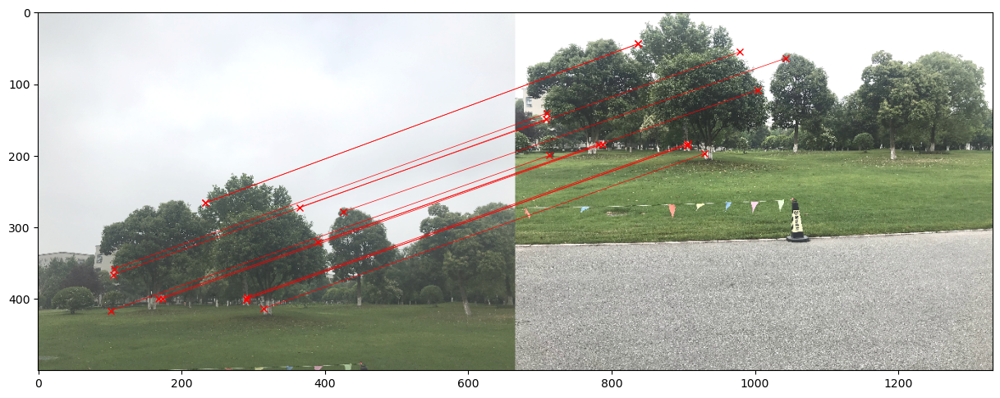

In [ ]:
plot_matches(inliers, total_img) # show inliers matches

In [ ]:
def is_close_to_black(pixel, threshold=0.4):
    black = np.zeros(3)  # Black pixel
    distance = np.linalg.norm(pixel - black)  # Euclidean distance
    print(distance)
    return distance < threshold

In [ ]:
is_close_to_black([10, 10, 5], threshold=30)

15.0


True

In [ ]:
def stitch_img(left, right, H):
    print("stiching image ...")
    
    # Convert to double and normalize. Avoid noise.
    left = cv2.normalize(left.astype('float'), None, 0.0, 1.0, cv2.NORM_MINMAX)   
    # Convert to double and normalize.
    right = cv2.normalize(right.astype('float'), None, 0.0, 1.0, cv2.NORM_MINMAX)   
    
    # left image
    height_l, width_l, channel_l = left.shape
    corners = [[0, 0, 1], [width_l, 0, 1], [width_l, height_l, 1], [0, height_l, 1]]
    corners_new = [np.dot(H, corner) for corner in corners]
    corners_new = np.array(corners_new).T 
    x_news = corners_new[0] / corners_new[2]
    y_news = corners_new[1] / corners_new[2]
    y_min = min(y_news)
    x_min = min(x_news)

    translation_mat = np.array([[1, 0, -x_min], [0, 1, -y_min], [0, 0, 1]])
    H = np.dot(translation_mat, H)
    
    # Get height, width
    height_new = int(round(abs(y_min) + height_l))
    width_new = int(round(abs(x_min) + width_l))
    size = (width_new, height_new)

    # right image
    warped_l = cv2.warpPerspective(src=left, M=H, dsize=size)

    height_r, width_r, channel_r = right.shape
    
    height_new = int(round(abs(y_min) + height_r))
    width_new = int(round(abs(x_min) + width_r))
    size = (width_new, height_new)
    

    warped_r = cv2.warpPerspective(src=right, M=translation_mat, dsize=size, borderMode = cv2.BORDER_CONSTANT, borderValue=(0,0,0))
     
    black = np.zeros(3)  # Black pixel.
    # Stitching procedure, store results in warped_l.
    for i in tqdm(range(warped_r.shape[0])):
        for j in range(warped_r.shape[1]):
            pixel_l = warped_l[i, j, :]
            pixel_r = warped_r[i, j, :]
            

            if not  is_close_to_black(pixel_l)  and not  is_close_to_black(pixel_r) :
                warped_l[i, j, :] = (pixel_l + pixel_r) / 2
            elif not is_close_to_black(pixel_l) and is_close_to_black(pixel_r) :
                warped_l[i, j, :] = pixel_l
            elif  is_close_to_black(pixel_l) and not is_close_to_black(pixel_r) :
                warped_l[i, j, :] = pixel_r
            else:
                warped_l[i, j, :] = (pixel_l + pixel_r) / 2
                  
    stitch_image = warped_l[:warped_r.shape[0], :warped_r.shape[1], :]
    return stitch_image

In [ ]:
final_result = stitch_img(left_rgb, right_rgb, H)

stiching image ...
[0.95170943 0.96274728 0.98353283]


  0%|          | 0/863 [00:00<?, ?it/s]

1.4567380282752678
0.0
1.4567380282752678
0.0
1.3656919015080635
0.0
1.3656919015080635
0.0
1.3218342722131158
0.0
1.3218342722131158
0.0
1.2336360364779444
0.0
1.2336360364779444
0.0
1.1464816083962828
0.0
1.1464816083962828
0.0
1.1004216486447855
0.0
1.1004216486447855
0.0
1.0052473939621567
0.0
1.0052473939621567
0.0
0.9160039456552309
0.0
0.9160039456552309
0.0
0.8711765392287778
0.0
0.8711765392287778
0.0
0.7794737456257487
0.0
0.7794737456257487
0.0
0.7336223488242339
0.0
0.7336223488242339
0.0
0.6410596016297824
0.0
0.6410596016297824
0.0
0.5483487989219732
0.0
0.5483487989219732
0.0
0.5045306080008454
0.0
0.5045306080008454
0.0
0.4120313888118681
0.0
0.4120313888118681
0.0
0.3187335298198214
0.3187335298198214
0.3187335298198214
0.0
0.273849376095705
0.273849376095705
0.273849376095705
0.0
0.1824837711568115
0.1824837711568115
0.1824837711568115
0.0
0.09106672280566326
0.09106672280566326
0.09106672280566326
0.0
0.04564671839866854
0.04564671839866854
0.04564671839866854
0.0
0.

: 

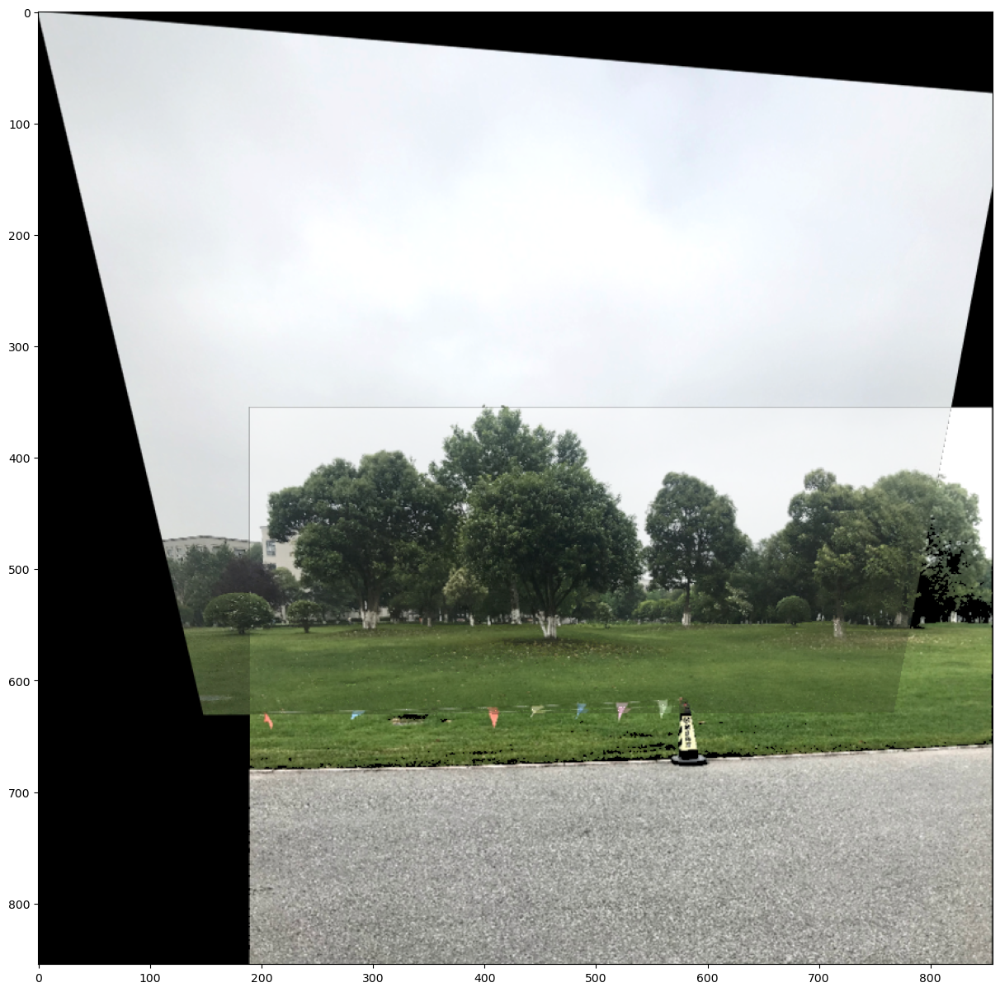

In [ ]:
plt.imshow(final_result)
plt.imsave("test2_ABC.jpg", final_result)


In [ ]:
import cv2
import numpy as np

def gradient_blend(image1, image2):
    # Compute gradient masks
    mask1 = np.linspace(1, 0, image1.shape[1])[:, np.newaxis]
    mask2 = np.linspace(0, 1, image2.shape[1])[:, np.newaxis]

    # Blend images using gradient masks
    blended_image = np.hstack((image1[:, :image1.shape[1]//2] * mask1,
                               image2[:, image2.shape[1]//2:] * mask2))

    return blended_image.astype(np.uint8)

# Load images
image1 = cv2.imread("CV-image/test/1/4.jpg")
image2 = cv2.imread("CV-image/test/1/5.jpg")

# Perform gradient blending
blended_image = gradient_blend(image1, image2)

# Display the blended image
cv2.imshow('Blended Image', blended_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

ValueError: operands could not be broadcast together with shapes (3024,2016,3) (4032,1) 